In [1]:
import pandas as pd
import numpy as np

In [2]:
import matplotlib.pyplot as plt
import matplotlib.ticker as ticker
import seaborn as sns
import plotly.graph_objects as go
import plotly.express as px
import folium

In [3]:
volume_bucket = ['Less than S500M', 'From S500M to $1B', 'From $1B to $1.5B', 'More than $1.5B']

type_desc = {
    11: 'Full Service, brick and mortar office',
    12: 'Full Service, retail office',
    13: 'Full Service, home banking',
    21: 'Limited Service, administrative office',
    22: 'Limited Service, military facility',
    23: 'Limited Service, drive-through facility',
    24: 'Limited Service, load production office',
    25: 'Limited Service, consumer credit office',
    26: 'Limited Service, contractual office',
    27: 'Limited Service, messenger office',
    28: 'Limited Service, retail office',
    29: 'Limited Service, mobile-seasonal office',
    30: 'Limited Service, trust office'}

bkclass_desc = {
    
    'N': 'NATIONAL MEMBER BANKS',
    'SM': 'STATE MEMBER BANKS',
    'NM': 'STATE NONMEMBER BANKS',
    'SI': 'STOCK AND MUTUAL SAVINGS BANKS',
    'SB': 'SAVINGS BANKS AND SAVINGS AND LOANS',
    'SL': 'STATE STOCK SAVINGS AND LOANS',
    'OI': 'OTHER INSURED INSTITUTIONS',
    'NC': 'NONINSURED INSTITUTIONS',
    'NS': 'NONINSURED SAVINGS INSTITUTIONS AND INSURANCE',
    'CU': 'CREDIT UNIONS'}

Northeast = ['Connecticut', 'Maine', 'Massachusetts', 'New Hampshire', 'Rhode Island', 'Vermont',
             'New Jersey', 'New York', 'Pennsylvania']
Midwest = ['Illinois', 'Indiana', 'Michigan', 'Ohio', 'Wisconsin', 'Iowa', 'Kansas', 'Minnesota', 'Missouri',
           'Nebraska', 'North Dakota', 'South Dakota']
South = ['Delaware', 'Florida', 'Georgia', 'Maryland', 'North Carolina', 'South Carolina', 'Virginia', 
         'District Of Columbia', 'West Virginia', 'Alabama', 'Kentucky', 'Mississippi', 'Tennessee',
         'Arkansas', 'Louisiana', 'Oklahoma', 'Texas']
West = ['Arizona', 'Colorado', 'Idaho', 'Montana','Nevada', 'New Mexico', 'Utah', 'Wyoming', 'Alaska', 
        'California', 'Hawaii', 'Oregon', 'Washington']
OtherTerritories = ['Federated States Of Micronesia','Puerto Rico', 'Guam', 'American Samoa','Virgin Islands Of The U.S.', 
                    'Marshall Islands', 'Northern Mariana Islands', 'Palau']



In [4]:
def format_float_with_commas(x):
    if isinstance(x, (int, float)):
            return '{:,.2f}'.format(x)  # Format float with 2 decimal places and commas
    return x


def add_features(df):
    df['STNAME'] = df['STNAME'].str.title()
    df['ASSETAVG'] = round(df.groupby('NAMEFULL')['ASSET'].transform(lambda x: x / x.count()),0)
    df['DEPDOMAVG'] = round(df.groupby('NAMEFULL')['DEPDOM'].transform(lambda x: x / x.count()),0)
    regionsbr_condlist = [df['STNAMEBR'].isin(Northeast), df['STNAMEBR'].isin(Midwest), df['STNAMEBR'].isin(South), 
                        df['STNAMEBR'].isin(West), df['STNAMEBR'].isin(OtherTerritories)]
    regionsbr_choicelist = ['Northeast', 'Midwest', 'South', 'West', 'Other']  
    regions_condlist = [df['STNAME'].isin(Northeast), df['STNAME'].isin(Midwest), df['STNAME'].isin(South), 
                        df['STNAME'].isin(West), df['STNAME'].isin(OtherTerritories)]
    regions_choicelist = ['Northeast', 'Midwest', 'South', 'West', 'Other']
    df['BRSERTYP_DSCR'] = df['BRSERTYP'].map(type_desc)
    df['BKCLASS_DSCR'] = df['BKCLASS'].map(bkclass_desc)
    df['ASSETNBR'] = pd.cut(df['ASSET'], bins = 4, include_lowest = True)
    df['ASSETCAT'] = pd.cut(df['ASSET'], bins = 4, labels = volume_bucket, include_lowest = False)
    df['DEPDOMNBR'] = pd.cut(df['DEPDOM'], bins = 4, include_lowest = True)
    df['DEPDOMCAT'] = pd.cut(df['DEPDOM'], bins = 4, labels = volume_bucket, include_lowest = False)
    df['BNKBRREGION'] = np.select(regionsbr_condlist, regionsbr_choicelist)
    df['BNKREGION'] = np.select(regions_condlist, regions_choicelist)
    return df


def get_count_branches_by_state(df, state = 'California'):

    df_rollup = df.loc[df["STNAMEBR"] == state].groupby(['NAMEFULL', "STNAMEBR"])[['ASSET']].count().reset_index()
    df_rollup = df_rollup.sort_values(by = 'ASSET', ascending = False)[:10].reset_index(drop = True)
    df_rollup['PCT'] = df_rollup['ASSET'] / df_rollup['ASSET'].sum()
    df_rollup = df_rollup.applymap(format_float_with_commas)
    df_rollup.rename(columns = {'ASSET': 'COUNTBR'}, inplace = True)
    
    return df_rollup 


def get_bank_region_detail(df, region_type = "BNKREGION", attributes_list = ["ASSET", "DEPDOM"], sort_by = ["ASSET"], asc = False):

    df_rollup = (df.groupby(region_type)[attributes_list].sum().sort_values(by = sort_by, ascending = asc).
                reset_index())
    total_row = pd.DataFrame(df_rollup.sum(), columns =['Total']).T
    df_rollup = pd.concat([df_rollup, total_row]).reset_index(drop= True)
    df_rollup.loc[df_rollup.index[-1], ["BNKREGION"]] =  "Total"

    for col in df_rollup.columns[1:]:
        df_rollup[col] = df_rollup[col].astype(float)
        df_rollup[col + 'CUML'] = df_rollup[col].cumsum()
        df_rollup.loc[df_rollup.index[-1],[col  + 'CUML']] = ''
        df_rollup[col + 'PCT'] = df_rollup[col] / df_rollup.loc[df_rollup.index[-1],[col]].sum() * 100
        df_rollup[col + 'PCTCUML'] = df_rollup[col + 'PCT'].cumsum()
        df_rollup.loc[df_rollup.index[-1],[col  + 'PCTCUML']] = ''

    df_rollup = df_rollup.applymap(format_float_with_commas)

    return df_rollup


def get_asset_deposits_rank(df, asc_ = False):
    rank_df = pd.DataFrame(df.loc[df['ASSET']>0].groupby(['RSSDID', 'NAMEFULL'])[['ASSET', 'DEPDOM']].sum().sort_values(by = ['ASSET', 'DEPDOM'], ascending=[False,False])[:20])
    rank_df['ASSETPCT'] = rank_df['ASSET'] / rank_df['ASSET'].sum() * 100
    rank_df['DEPDOMPCT'] = rank_df['DEPDOM'] / rank_df['DEPDOM'].sum() * 100
    rank_df = rank_df.style.format("{:,.2f}")
    return rank_df


def get_branch_desc(df, asc_ = False):
    rank_df = pd.DataFrame(df.loc[df['ASSET']>0].groupby(['RSSDID', 'NAMEFULL', 'BRSERTYP_DSCR'])['ASSET'].sum().reset_index().sort_values(by = ['ASSET'],
                                                                                                                            ascending = asc_)[:20])
    rank_df = pd.pivot_table(data = rank_df, index = ['RSSDID', 'NAMEFULL'], columns = ['BRSERTYP_DSCR'], 
                                values = ['ASSET'], aggfunc = np.sum, fill_value= 0).reset_index()
    rank_df.columns = [' '.join(col).strip() for col in rank_df.columns.values]
    rank_df.columns = rank_df.columns.str.replace('ASSET ', '', regex = True)
    rank_df['TTLASSET'] = rank_df.iloc[:, 2:].sum(axis = 1)
    rank_df['TTLASSETPCT'] = rank_df['TTLASSET'] / rank_df['TTLASSET'].sum() * 100
    rank_df = rank_df.sort_values(by = ['TTLASSET'], ascending=False).reset_index(drop= True)
    rank_df.loc[rank_df.index[-1]] = rank_df.sum()

    rank_df.loc[rank_df.index[-1], ['RSSDID', 'NAMEFULL']] = ['Total', '']
    rank_df = rank_df.applymap(format_float_with_commas)
    rank_df['RSSDID'] = rank_df['RSSDID'].replace({',':''}, regex = True).replace({'.00':''}, regex = True)

    return rank_df


def get_tree_graphs(df, path, values):
        
    fig = px.treemap(df,
               path=path,
               values= values,
               color_continuous_scale="RdBu")
    fig.show()
    
    
def color_function(value):
    if value == 'Less than S500M':
        return 'orange'
    elif value == 'From S500M to $1B':
        return 'green'
    elif value == 'From $1B to $1.5B':
        return 'red'
    else:
        return 'blue'
        
        
def get_map_analysis(df):
    # The total number of branches is too much for Kaggle to handle
    # Comment them out the following two lines if you are running in your computer
    df = df.sort_values(by = ['ASSET'], ascending = False)
    df = df.iloc[:10000, :]

    map_center = [df['latitude'].mean(), df['longitude'].mean()]
    mymap = folium.Map(location=map_center, zoom_start=4)


    for index, row in df.iterrows():
        folium.CircleMarker(
            location=(row['latitude'], row['longitude']),
            radius=4,
            color=color_function(row['ASSETCAT']),
            fill=True,
            fill_color=color_function(row['ASSETCAT']),
            fill_opacity=0.7,
            popup= f'Name:{row["NAMEFULL"]}\n Branch:{row["NAMEBR"]}\n Assets($):{row["ASSET"]:,.0f}\n Deposits($):{row["DEPDOM"]:,.0f}'
        ).add_to(mymap)

    return mymap
    

def get_bank_distribution(df):
    asset = df['ASSET']
    deposit = df['DEPDOM']

    plt.figure(figsize=(10, 6))  # Set figure size

    plt.hist(asset, bins=10, color='blue', edgecolor='black', alpha=0.5, label='Asset Size')
    plt.hist(deposit, bins=10, color='red', edgecolor='black', alpha=0.5, label='Deposit Size')

    plt.title("Asset and Deposit Distribution", fontsize=16)
    plt.xlabel("Amount in Dollars", fontsize=14)
    plt.ylabel("Frequency", fontsize=14)

    formatter = ticker.FuncFormatter(lambda x, pos: '${:.1f}{}'.format(x * 1e-9 if x >= 1e9 else x * 1e-6, 'B' if x >= 1e9 else 'M'))
    plt.gca().xaxis.set_major_formatter(formatter)

    plt.gca().spines['top'].set_visible(False)
    plt.gca().spines['right'].set_visible(False)

    plt.legend()
    plt.tight_layout()
    plt.show()


    
def barh_recursive_plot(df, volume_cat, region = 'BNKREGION', volume_col = 'DENOVOCAT', volume = 'ASSET'):
    
    plt.figure(figsize=(10, 6))
    
    data = df.loc[df[volume_col]== volume_cat,:].groupby(region)[[volume]].sum().reset_index()
    regions = pd.DataFrame(['Northeast', 'Midwest', 'South', 'West', 'Other'], columns = [region])
    data = pd.merge(data, regions, how = 'right', on = region).fillna(0).sort_values(by = volume, ascending = True)
        
    categories = data[region]
    values = data[volume]
    display(data.loc[:,[region, volume]])
    plt.barh(categories, width = values, alpha = 0.7)

    plt.title('Composition in {}'.format(volume_cat), fontsize = 16)
    formatter = ticker.FuncFormatter(lambda x, pos: '${:.1f}{}'.format(x * 1e-9 if x >= 1e9 else x * 1e-6, 'B' if x >= 1e9 else 'M'))
    plt.gca().xaxis.set_major_formatter(formatter)
    plt.xlabel("Amount in Dollars", fontsize=12) 
    plt.ylabel("Categories", fontsize=12) 

    for bar in plt.gca().patches:
        num_ = bar.get_width()
        formatted_number = '$ {:.1f}{}'.format(num_ * 1e-9 if num_ >= 1e9 else num_ * 1e-6, 'B' if num_ >= 1e9 else 'M')
        plt.text(bar.get_width() + 0.1, bar.get_y() + bar.get_height() / 2, f'{formatted_number}', va='center')

    plt.gca().spines['top'].set_visible(False)
    plt.gca().spines['right'].set_visible(False)

    plt.tight_layout()
    plt.show()

In [5]:
# df = pd.read_csv('/kaggle/input/u-s-fdic-insured-banks-and-financial-institution/Federal_Deposit_Insurance_Corporation_FDIC_Insured_Banks.csv',
#                 low_memory = False)

df = pd.read_csv('Federal_Deposit_Insurance_Corporation_FDIC_Insured_Banks.csv',low_memory=False)
df = add_features(df)
df.rename(columns = { 'x': 'longitude', 'y': 'latitude'}, inplace = True)


In [6]:
df.head().T

,0,1,2,3,4
index,0,1,2,3,4
FID,13001,13002,13003,13004,13005
ADDRESBR,950 Park Street,97 Lowell Road,342 Main Street,121 Main Street,205 Main St
BRNUM,0,360,0,0,0
BRSERTYP,11,11,11,11,11
CBSABR,14460,14460,14460,12700,0
CBSANAMB,"Boston-Cambridge-Newton, MA-NH","Boston-Cambridge-Newton, MA-NH","Boston-Cambridge-Newton, MA-NH","Barnstable Town, MA",
CITYBR,Stoughton,Concord,Wakefield,Yarmouth Port,Frost
CNTRYNAB,United States,United States,United States,United States,United States
CNTYNAMB,Norfolk,Middlesex,Middlesex,Barnstable,Faribault


In [7]:
df.shape

(94725, 53)

In [8]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 94725 entries, 0 to 94724
Data columns (total 53 columns):
 #   Column         Non-Null Count  Dtype   
---  ------         --------------  -----   
 0   index          94725 non-null  int64   
 1   FID            94725 non-null  int64   
 2   ADDRESBR       94725 non-null  object  
 3   BRNUM          94725 non-null  int64   
 4   BRSERTYP       94725 non-null  int64   
 5   CBSABR         94725 non-null  int64   
 6   CBSANAMB       94725 non-null  object  
 7   CITYBR         94725 non-null  object  
 8   CNTRYNAB       94725 non-null  object  
 9   CNTYNAMB       94725 non-null  object  
 10  DEPSUMBR       94725 non-null  int64   
 11  GEOCODE_CE     94725 non-null  object  
 12  GEOCODE__1     94725 non-null  object  
 13  NAMEBR         94725 non-null  object  
 14  STALPBR        94725 non-null  object  
 15  STCNTYBR       94725 non-null  int64   
 16  STNAMEBR       94725 non-null  object  
 17  UNINUMBR       94725 non-null  

In [9]:
df.to_csv('FDIC_with_features.csv')

In [10]:
df_dedup = df.drop_duplicates(subset = ['NAMEFULL'], keep = 'last').copy()

In [11]:
df_dedup.shape

(5746, 53)

In [12]:
# df_dedup.to_csv('FDIC_with_features_DEDUP.csv')

In [13]:
get_map_analysis(df)

In [14]:
path = ["STNAME", "CITY"]
values = "ASSET"
get_tree_graphs(df_dedup, path, values)

In [15]:
path = ["STNAME", "CITY"]
values = "DEPDOM"
get_tree_graphs(df_dedup, path, values)

In [16]:
path = ["BNKREGION","STNAME"]
values = "ASSET"
get_tree_graphs(df_dedup, path, values)

In [17]:
path = ["BNKREGION","STNAME"]
values = "DEPDOM"
get_tree_graphs(df_dedup, path, values)

In [18]:
path = ["STNAMEBR", "CITYBR"]
values = "ASSET"
get_tree_graphs(df_dedup, path, values)

In [19]:
path = ["STNAMEBR", "CITYBR"]
values = "ASSETAVG"
get_tree_graphs(df, path, values)

In [20]:
path = ["STNAMEBR", "CITYBR"]
values = "DEPDOMAVG"
get_tree_graphs(df, path, values)

In [21]:
for state in ['California', 'New York', 'Texas', 'Florida', 'Illinois', 'Pennsylvania']:
    print('Number of branches in {}'.format(state))
    display(get_count_branches_by_state(df, state = state))

Number of branches in California


,NAMEFULL,STNAMEBR,COUNTBR,PCT
0,"JPMorgan Chase Bank, National Association",California,"1,057.00",0.21
1,"Wells Fargo Bank, National Association",California,"1,057.00",0.21
2,"Bank of America, National Association",California,935.00,0.19
3,U.S. Bank National Association,California,666.00,0.13
4,"Citibank, National Association",California,384.00,0.08
5,"Union Bank, National Association",California,365.00,0.07
6,Bank of the West,California,251.00,0.05
7,"Rabobank, National Association",California,121.00,0.02
8,Comerica Bank,California,103.00,0.02
9,Umpqua Bank,California,101.00,0.02


Number of branches in New York


,NAMEFULL,STNAMEBR,COUNTBR,PCT
0,"JPMorgan Chase Bank, National Association",New York,801.00,0.27
1,"Bank of America, National Association",New York,321.00,0.11
2,"Citibank, National Association",New York,271.00,0.09
3,"Capital One, National Association",New York,267.00,0.09
4,Manufacturers and Traders Trust Company,New York,259.00,0.09
5,KeyBank National Association,New York,249.00,0.09
6,"TD Bank, National Association",New York,242.00,0.08
7,"First Niagara Bank, National Association",New York,199.00,0.07
8,"HSBC Bank USA, National Association",New York,156.00,0.05
9,"Community Bank, National Association",New York,155.00,0.05


Number of branches in Texas


,NAMEFULL,STNAMEBR,COUNTBR,PCT
0,"Wells Fargo Bank, National Association",Texas,687.00,0.20
1,"JPMorgan Chase Bank, National Association",Texas,676.00,0.20
2,"Bank of America, National Association",Texas,429.00,0.13
3,Compass Bank,Texas,345.00,0.10
4,First National Bank Texas,Texas,286.00,0.08
5,Prosperity Bank,Texas,266.00,0.08
6,Woodforest National Bank,Texas,207.00,0.06
7,"Capital One, National Association",Texas,171.00,0.05
8,International Bank of Commerce,Texas,168.00,0.05
9,Comerica Bank,Texas,138.00,0.04


Number of branches in Florida


,NAMEFULL,STNAMEBR,COUNTBR,PCT
0,"Wells Fargo Bank, National Association",Florida,652.00,0.19
1,"Bank of America, National Association",Florida,607.00,0.17
2,SunTrust Bank,Florida,511.00,0.15
3,"JPMorgan Chase Bank, National Association",Florida,383.00,0.11
4,Regions Bank,Florida,363.00,0.10
5,Branch Banking and Trust Company,Florida,325.00,0.09
6,"PNC Bank, National Association",Florida,196.00,0.06
7,Fifth Third Bank,Florida,170.00,0.05
8,"TD Bank, National Association",Florida,166.00,0.05
9,"BankUnited, National Association",Florida,99.00,0.03


Number of branches in Illinois


,NAMEFULL,STNAMEBR,COUNTBR,PCT
0,"JPMorgan Chase Bank, National Association",Illinois,383.00,0.21
1,U.S. Bank National Association,Illinois,244.00,0.14
2,BMO Harris Bank National Association,Illinois,212.00,0.12
3,"PNC Bank, National Association",Illinois,195.00,0.11
4,"Bank of America, National Association",Illinois,174.00,0.10
5,Fifth Third Bank,Illinois,166.00,0.09
6,TCF National Bank,Illinois,159.00,0.09
7,North Community Bank,Illinois,93.00,0.05
8,"MB Financial Bank, National Association",Illinois,85.00,0.05
9,"Citibank, National Association",Illinois,72.00,0.04


Number of branches in Pennsylvania


,NAMEFULL,STNAMEBR,COUNTBR,PCT
0,"PNC Bank, National Association",Pennsylvania,463.00,0.20
1,Citizens Bank of Pennsylvania,Pennsylvania,361.00,0.16
2,"Wells Fargo Bank, National Association",Pennsylvania,284.00,0.12
3,First National Bank of Pennsylvania,Pennsylvania,250.00,0.11
4,Manufacturers and Traders Trust Company,Pennsylvania,205.00,0.09
5,Susquehanna Bank,Pennsylvania,179.00,0.08
6,"Santander Bank, N.A.",Pennsylvania,164.00,0.07
7,Northwest Savings Bank,Pennsylvania,139.00,0.06
8,"First Niagara Bank, National Association",Pennsylvania,129.00,0.06
9,National Penn Bank,Pennsylvania,116.00,0.05


In [22]:
get_bank_region_detail(df_dedup, region_type = "BNKREGION", attributes_list = ["ASSET", "DEPDOM"], sort_by = ["ASSET"], asc = False)

,BNKREGION,ASSET,DEPDOM,ASSETCUML,ASSETPCT,ASSETPCTCUML,DEPDOMCUML,DEPDOMPCT,DEPDOMPCTCUML
0,Midwest,"6,623,574,046.00","3,878,609,393.00","6,623,574,046.00",45.03,45.03,"3,878,609,393.00",39.74,39.74
1,South,"4,866,897,793.00","3,599,420,838.00","11,490,471,839.00",33.09,78.12,"7,478,030,231.00",36.88,76.61
2,Northeast,"1,716,451,486.00","1,135,763,076.00","13,206,923,325.00",11.67,89.80,"8,613,793,307.00",11.64,88.25
3,West,"1,431,991,292.00","1,096,484,197.00","14,638,914,617.00",9.74,99.53,"9,710,277,504.00",11.23,99.48
4,Other,"68,900,076.00","50,845,886.00","14,707,814,693.00",0.47,100.00,"9,761,123,390.00",0.52,100.00
5,Total,"14,707,814,693.00","9,761,123,390.00",,100.00,,,100.00,


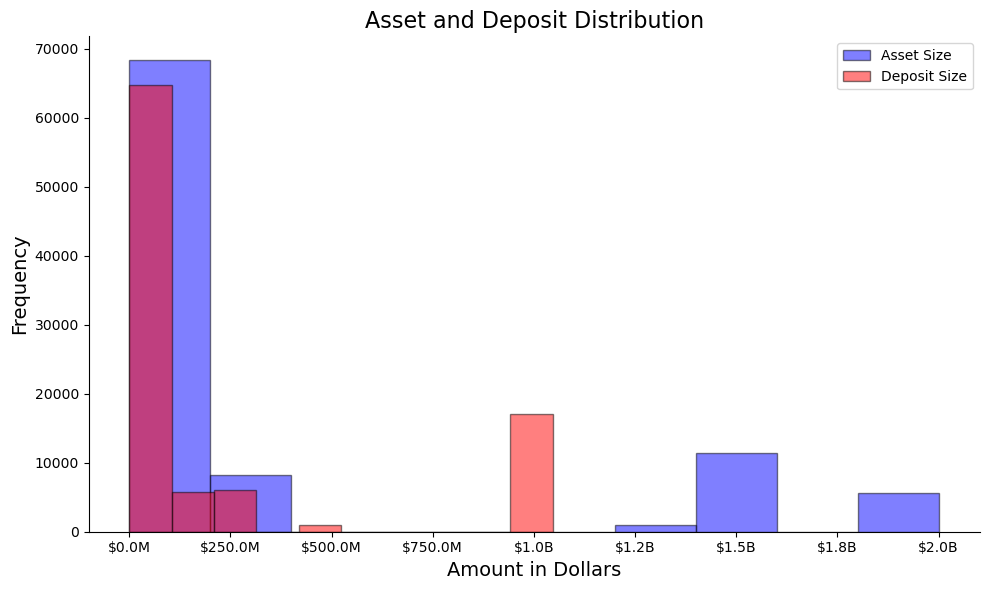

In [23]:
get_bank_distribution(df)

In [24]:
print(df.loc[df['NAMEFULL'] == 'JPMorgan Chase Bank, National Association']['ASSET'].max())
print(df.loc[df['NAMEFULL'] == 'JPMorgan Chase Bank, National Association']['ASSET'].mean())
print(df.loc[df['NAMEFULL'] == 'JPMorgan Chase Bank, National Association']['ASSET'].min())

2002047000
2002047000.0
2002047000


In [25]:
more1B = df.loc[df['ASSETCAT'] == 'More than $1.5B', ['NAMEFULL', 'NAMEBR', 'STNAMEBR', 'ASSET', 'DEPDOM']].sort_values(by = 'ASSET', ascending = False).reset_index(drop = True)
more1B = more1B.applymap(format_float_with_commas)
more1B

,NAMEFULL,NAMEBR,STNAMEBR,ASSET,DEPDOM
0,"JPMorgan Chase Bank, National Association",Arboretum Branch,Texas,"2,002,047,000.00","1,032,549,000.00"
1,"JPMorgan Chase Bank, National Association",Firewheel Banking Center Branch,Texas,"2,002,047,000.00","1,032,549,000.00"
2,"JPMorgan Chase Bank, National Association",Big Beaver and John R Bkg. Ctr. Branch,Michigan,"2,002,047,000.00","1,032,549,000.00"
3,"JPMorgan Chase Bank, National Association",East Norwich Banking Ctr. Branch,New York,"2,002,047,000.00","1,032,549,000.00"
4,"JPMorgan Chase Bank, National Association",Heb Georgetown Banking Ctr. Branch,Texas,"2,002,047,000.00","1,032,549,000.00"
...,...,...,...,...,...
5674,"JPMorgan Chase Bank, National Association",South Mountain Branch,Arizona,"2,002,047,000.00","1,032,549,000.00"
5675,"JPMorgan Chase Bank, National Association",Bullhead City Branch,Arizona,"2,002,047,000.00","1,032,549,000.00"
5676,"JPMorgan Chase Bank, National Association",Sun City-Lakeview Branch,Arizona,"2,002,047,000.00","1,032,549,000.00"
5677,"JPMorgan Chase Bank, National Association",Southview Branch,Ohio,"2,002,047,000.00","1,032,549,000.00"


In [26]:
df['ASSETCAT'].unique()

['Less than S500M', 'From $1B to $1.5B', 'More than $1.5B']
Categories (4, object): ['Less than S500M' < 'From S500M to $1B' < 'From $1B to $1.5B' < 'More than $1.5B']

In [27]:
regions = pd.DataFrame(['Northeast', 'Midwest', 'South', 'West', 'Other'], columns = ['BNKREGION'])
, region = 'BNKREGION', volume_col = 'DENOVOCAT', volume = 'ASSET'

('region',
 '=',
 "'BNKREGION',",
 'volume_col',
 '=',
 "'DENOVOCAT',",
 'volume',
 '=',
 "'ASSET'")

,BNKREGION,ASSET
4,Other,68900076
3,West,1431991292
0,Northeast,1716451486
1,Midwest,1816854046
2,South,3412155793


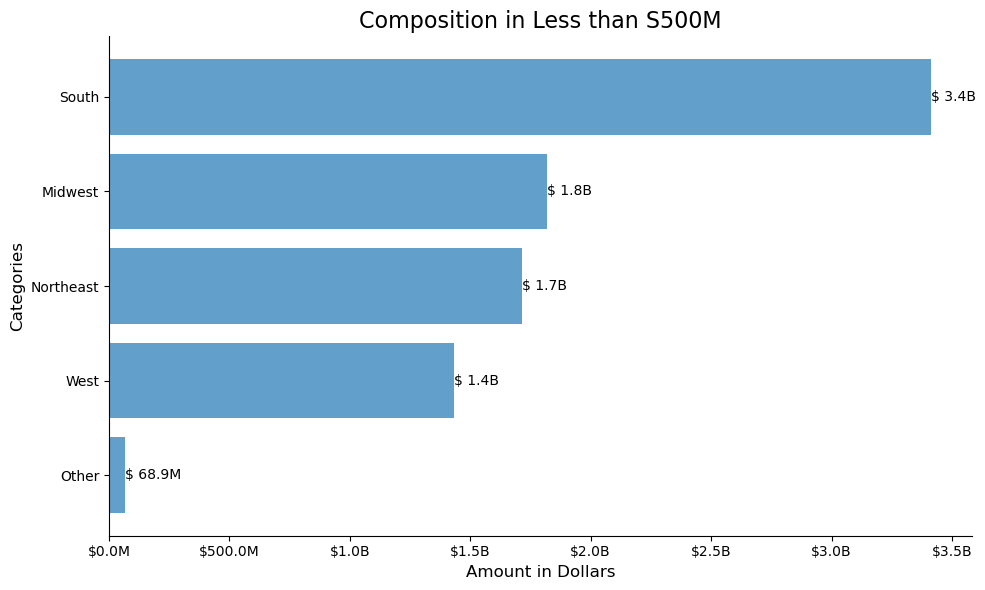

,BNKREGION,ASSET
0,Northeast,0.000000e+00
3,West,0.000000e+00
4,Other,0.000000e+00
2,South,1.454742e+09
1,Midwest,2.804673e+09


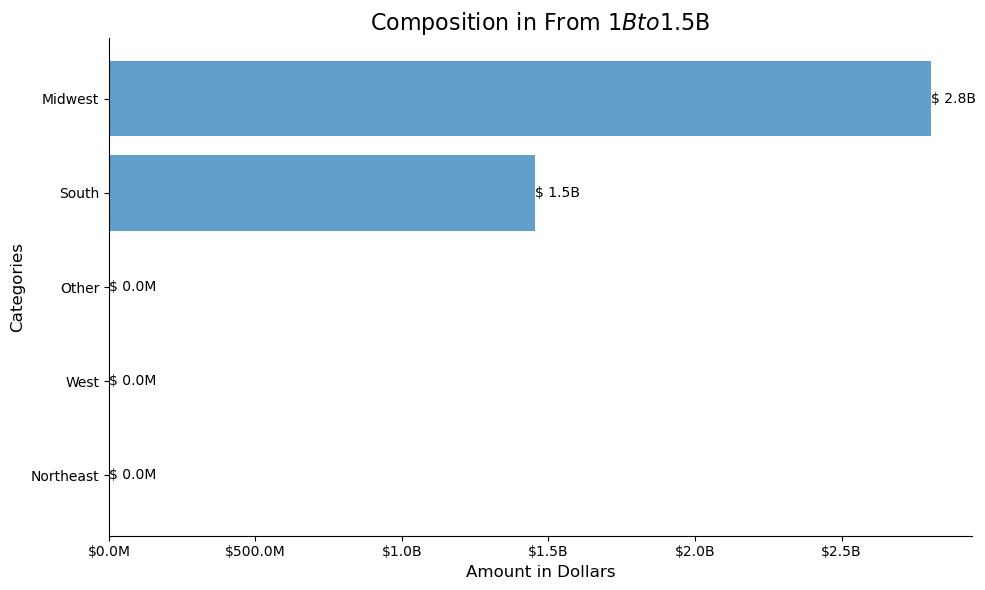

,BNKREGION,ASSET
0,Northeast,0.000000e+00
2,South,0.000000e+00
3,West,0.000000e+00
4,Other,0.000000e+00
1,Midwest,2.002047e+09


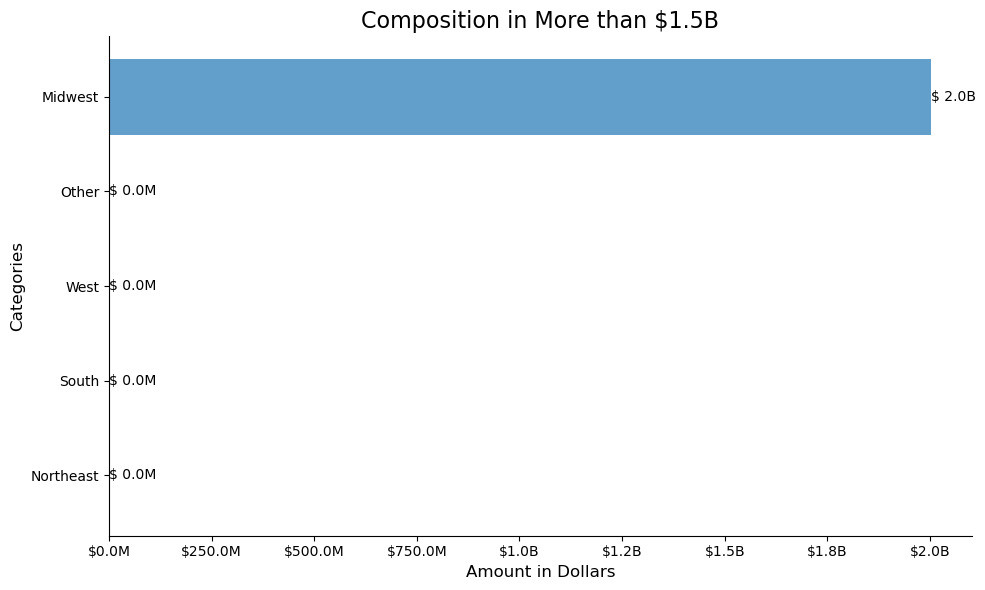

In [28]:
for cat in df_dedup['ASSETCAT'].unique():
    
    barh_recursive_plot(df_dedup, region = 'BNKREGION', volume_cat=cat, volume_col = 'ASSETCAT', volume = 'ASSET')

Less than S500M


,BNKREGION,DEPDOM
4,Other,50845886
1,Midwest,1095014046
3,West,1096484197
0,Northeast,1135763076
2,South,2553208838


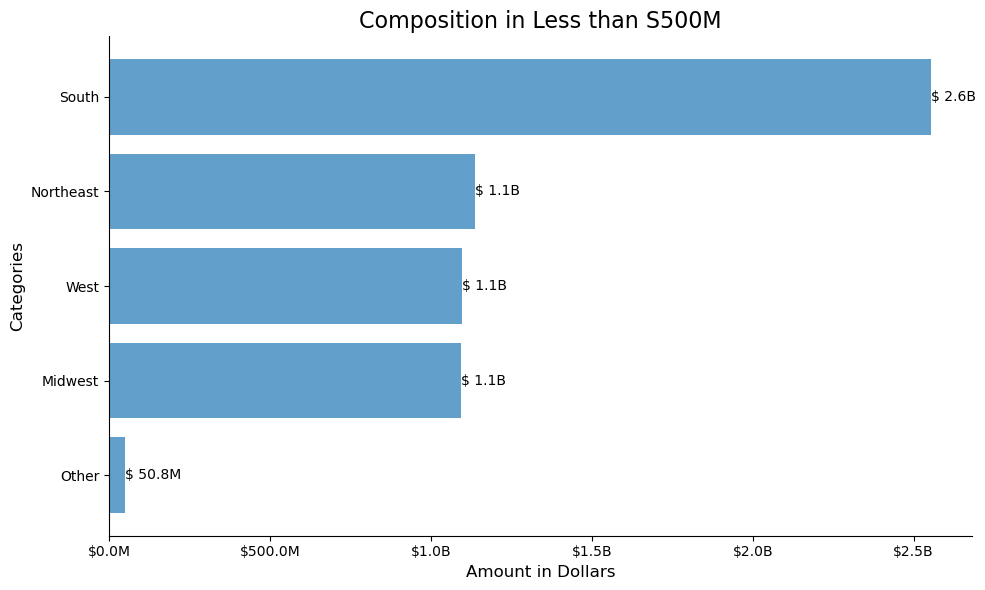

More than $1.5B


,BNKREGION,DEPDOM
0,Northeast,0.000000e+00
3,West,0.000000e+00
4,Other,0.000000e+00
2,South,1.046212e+09
1,Midwest,2.066169e+09


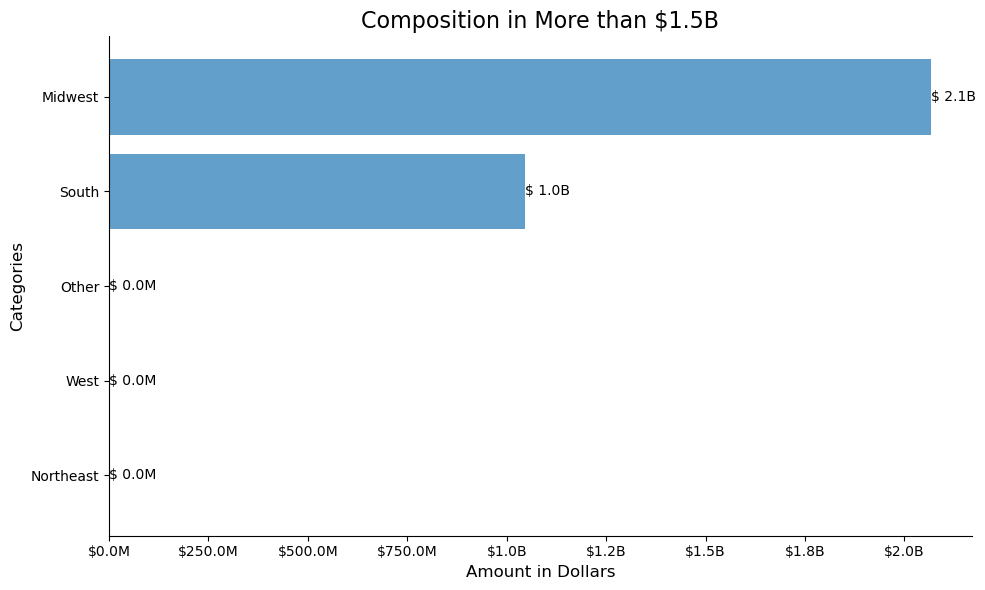

From S500M to $1B


,BNKREGION,DEPDOM
0,Northeast,0.0
2,South,0.0
3,West,0.0
4,Other,0.0
1,Midwest,717426347.0


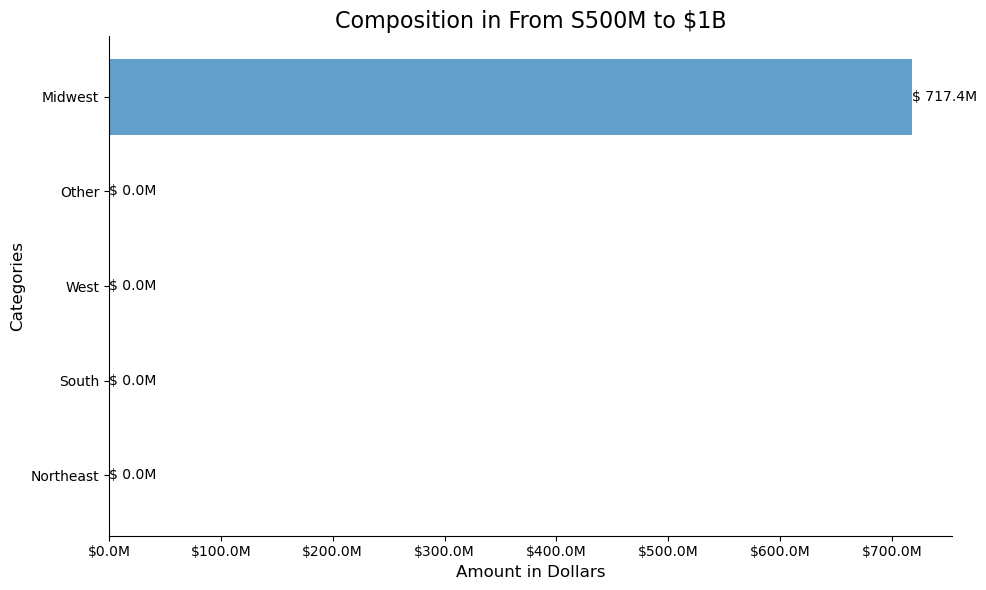

In [29]:
for cat in df['DEPDOMCAT'].unique():
    print(cat)
    barh_recursive_plot(df_dedup, region = 'BNKREGION', volume_cat=cat, volume_col = 'DEPDOMCAT', volume =  'DEPDOM')

In [30]:
top20 = get_asset_deposits_rank(df, True)
top20

,,ASSET,DEPDOM,ASSETPCT,DEPDOMPCT
RSSDID,NAMEFULL,,,,
852218,"JPMorgan Chase Bank, National Association","11,369,624,913,000.00","5,863,845,771,000.00",34.16,27.69
451965,"Wells Fargo Bank, National Association","9,066,384,680,000.00","6,522,142,200,000.00",27.24,30.80
480228,"Bank of America, National Association","7,410,455,748,000.00","5,329,403,928,000.00",22.26,25.17
476810,"Citibank, National Association","1,310,395,510,000.00","434,706,870,000.00",3.94,2.05
504713,U.S. Bank National Association,"1,244,018,902,704.00","853,735,441,586.00",3.74,4.03
817824,"PNC Bank, National Association","893,274,440,058.00","623,748,993,959.00",2.68,2.95
852320,Branch Banking and Trust Company,"338,425,171,033.00","254,000,044,714.00",1.02,1.20
497404,"TD Bank, National Association","291,705,093,600.00","246,489,621,840.00",0.88,1.16
675332,SunTrust Bank,"270,038,432,880.00","207,219,882,502.00",0.81,0.98


In [31]:
top20.index.get_level_values('NAMEFULL')

Index(['JPMorgan Chase Bank, National Association',
       'Wells Fargo Bank, National Association',
       'Bank of America, National Association',
       'Citibank, National Association', 'U.S. Bank National Association',
       'PNC Bank, National Association', 'Branch Banking and Trust Company',
       'TD Bank, National Association', 'SunTrust Bank',
       'Capital One, National Association', 'Regions Bank', 'Fifth Third Bank',
       'KeyBank National Association', 'Citizens Bank, National Association',
       'Manufacturers and Traders Trust Company',
       'BMO Harris Bank National Association', 'Santander Bank, N.A.',
       'Compass Bank', 'The Huntington National Bank',
       'Union Bank, National Association'],
      dtype='object', name='NAMEFULL')

In [36]:
def get_asset_deposits_rank_all(df, asc_ = False):
    rank_df = pd.DataFrame(df.loc[df['ASSET']>0].groupby(['RSSDID', 'NAMEFULL'])[['ASSET', 'DEPDOM']].sum().sort_values(by = ['ASSET', 'DEPDOM'], ascending=[False,False]))
    rank_df['ASSETPCT'] = rank_df['ASSET'] / rank_df['ASSET'].sum() * 100
    rank_df['DEPDOMPCT'] = rank_df['DEPDOM'] / rank_df['DEPDOM'].sum() * 100
#     rank_df = rank_df.style.format("{:,.2f}")
    return rank_df

In [37]:
assts_tot = get_asset_deposits_rank_all(df, asc_ = False)
assts_tot

,,ASSET,DEPDOM,ASSETPCT,DEPDOMPCT
RSSDID,NAMEFULL,,,,
852218,"JPMorgan Chase Bank, National Association",11369624913000,5863845771000,3.373402e+01,2.729230e+01
451965,"Wells Fargo Bank, National Association",9066384680000,6522142200000,2.690024e+01,3.035623e+01
480228,"Bank of America, National Association",7410455748000,5329403928000,2.198704e+01,2.480483e+01
476810,"Citibank, National Association",1310395510000,434706870000,3.887983e+00,2.023271e+00
504713,U.S. Bank National Association,1244018902704,853735441586,3.691041e+00,3.973570e+00
...,...,...,...,...,...
382274,Kentland Federal Savings and Loan Association,4861,3910,1.442273e-08,1.819845e-08
196752,TriCentury Bank,3994,3008,1.185032e-08,1.400024e-08
2569387,Independence Trust Company,3990,500,1.183845e-08,2.327167e-09


In [41]:
"{:,.2f}".format(assts_tot.ASSET.sum())

'33,703,737,699,798.00'